## <center>Meta Science for Decision Making: A Demo on Stakeholder Benefit Alignment</center> 
**<center>Victor Z. Chen</center>**

This project seeks to develop a working pipeline for aggregating domain knowledge and evidence silos into a unified, cumulative knowledge graph, which in turn can be easily accessed by data scientists to support their statistical and machine learning model development that represents the real-world relationships. Here is an overall of the architecture.

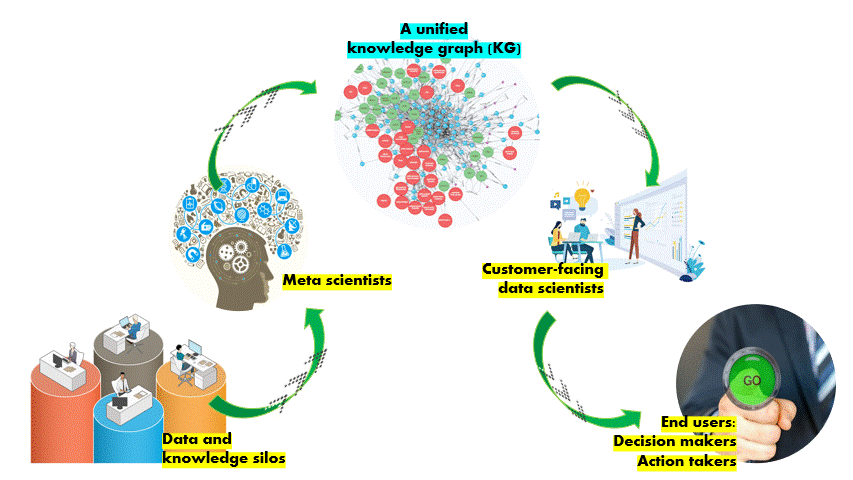

As a demostration, I present how to draw and manage meta-analytic evidence from social science research to understand cross-national institutional contexts of stakeholder capitalism. The raw data were sampled from my forthcoming ***Journal of Management*** publication on [<b>Multi-Stakeholder Agency: Stakeholder Benefit Alignment and National Institutional Contexts</b>](https://journals.sagepub.com/doi/abs/10.1177/01492063211054403) (co-authored with Patricio Duran, Steve Sauerwald, Mike Hitt, and Marc van Essen).

### 1. Research question
Are businesses aligning benefits across different stakeholder groups (i.e., investors, customers, employees, and the community at large)?
- ***RQ1: Are investor benefits positively related to customer benefits, employee benefits, and community benefits?***
- ***RQ2: How is the above relationship different across nations and over time?***
- ***RQ3: What national institutional contexts may explain such a difference?***

### 2. Data and sample
3,553 correlations were collected from 169 refereed publications in social sciences between 1972 and 2016. The sample is limited to single-country studies, so that we may identify nation-specific context information. These correlations suggest the statistical relationships between firm-level performance indicators concerning two different stakeholder groups These data represent over 182,000 firms in 29 countries between 1951 and 2012.

The data have been converted into a knowledge graph database, and stored on Neo4j AuraDB - a cloud-based knowledge graph database.

   - **The knowledge graph is running on the back end, and looks like the following when accessed through a graph platform.**

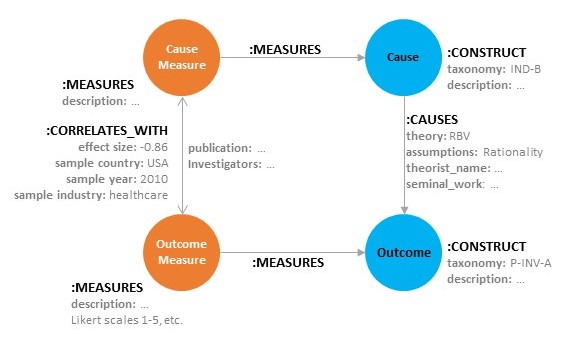

In [63]:
from IPython.display import Image
Image(filename='img/Fig2_schema.jpg')

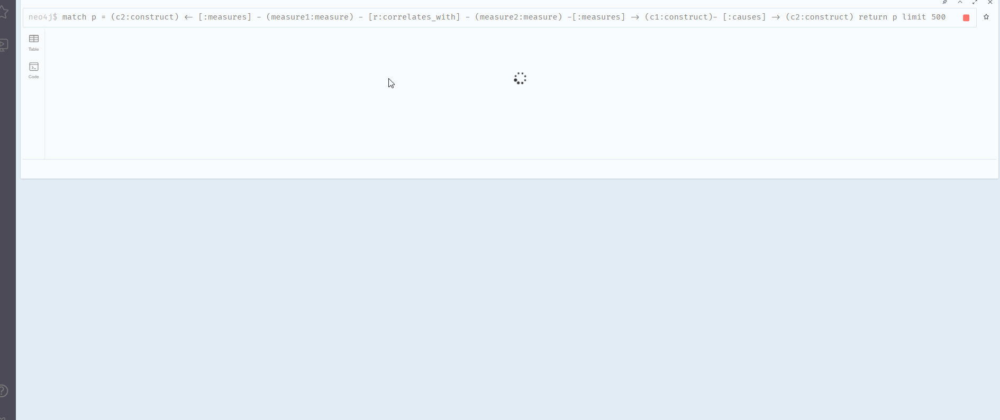

   - **Each unit of the knowledge graph, or the coding schema looks like the following.**

In [65]:
# load basic packages
import numpy as np
import pandas as pd
pd.set_option('display.max_columns', 100)
pd.set_option('display.max_rows', 100)
pd.options.display.float_format = '{:,.2f}'.format

# load visualization packages
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns
import plotly.graph_objects as go
import plotly.express as px

# Load/install graph packages
# !pip install --upgrade py2neo
# !pip install --upgrade neo4j
# !pip install neo4jupyter
from py2neo import Graph,Node,Relationship
from neo4j.exceptions import ServiceUnavailable
import neo4jupyter
neo4jupyter.init_notebook_mode()

# Load DAG display packages
from dowhy import CausalModel
import networkx as nx

# load statistical packages
from scipy import stats
import statsmodels.api as sm
import statsmodels.formula.api as smf

from sklearn.model_selection import cross_validate
from sklearn.model_selection import cross_val_score

from sklearn.linear_model import LinearRegression as Reg
from sklearn.linear_model import RidgeCV
from sklearn.linear_model import LassoCV

from sklearn.tree import DecisionTreeRegressor as Tree
from sklearn.svm import SVR
from sklearn.neural_network import MLPRegressor as NN

from sklearn.ensemble import AdaBoostRegressor as Boost
from sklearn.ensemble import BaggingRegressor as Bagging
from sklearn.ensemble import ExtraTreesRegressor as ExtraTree
from sklearn.ensemble import GradientBoostingRegressor as Gradient
from sklearn.ensemble import RandomForestRegressor as RF

# Import doc writing
import docx

<IPython.core.display.Javascript object>

#### 2.1 Data sanity-check and descriptive analysis

##### 2.1.1. query and load data from Neo4j AuraDB based on stakeholders of interest. For this demonstration, we show data representing the correlations of firm performance concerning the following three pairs of stakeholder groups.

- **Investors (INV)** and **customers (CUS)**
- **Investors (INV)** and **employees (EMP)**
- **Investors (INV)** and **the community (includng the environment) (COM)**

**<font color='red'><center>Notes for software developer: The following cell contains inputs from the user.</center><font>**

In [66]:
# Load the unified knowledge graph
load_uri = "neo4j+s://****" #emgp.editor@gmail.com login
load_pwd = "****"
graph_load = Graph(load_uri, auth=('neo4j', load_pwd))

# Ask the users to select which stakeholder pair they are interested in from the data
print("="*50)
select = int(input("""Please select one of the following stakeholder pairs: 
1 for Investors (INV) and customers (CUS), 
2 for Investors (INV) and employees (EMP), and 
3 for Investors (INV) and the community (includng the environment) (COM).
"""))

c1 = 'investor'
c2 = ['customer','employee','community'][select-1]

print("Thank you for your selection. We have loaded knowledge graph data for investor-%(c2)s benefit alignment.\n" % {'c2': c2})

dfcolumns_c = "c1.level1, c1.name, c2.level1, c2.name, "
dfcolumns_r = "r.publication, r.correlation, "
dfcolumns_sample = "r.sample_size_firms, r.sample_size_observations, r.sample_country, r.sample_year"
dfcolumns =  dfcolumns_c + dfcolumns_r + dfcolumns_sample

query = "MATCH p = (c1:construct) <-[m1:measures]- (v1:measure) -[r:correlates_with] -(v2:measure) -[m2:measures]-> (c2:construct) \
        WHERE c1.level1 ='%(c1)s benefits' AND c2.level1 ='%(c2)s benefits'\
        RETURN %(dfcolumns)s" % {'c1':c1, 'c2':c2, 'dfcolumns': dfcolumns}

df = graph_load.run(query).to_data_frame().drop_duplicates()
countries = df.sort_values(by = ['r.sample_country'])['r.sample_country'].dropna().unique().tolist()

w1 = "Number of correlations: " + str(df.shape[0])
w2 = "Number of observations: " + str(int(df.groupby('r.publication')['r.sample_size_observations'].mean().sum()))
w3 = "Number of firms: " + str(int(df.groupby('r.publication')['r.sample_size_firms'].mean().sum()))
w4 = "Year coverage: " + str(int(df['r.sample_year'].min())) + " ~ " + str(int(df['r.sample_year'].max()))
w5 = "Number of nations/markets: " + str(len(countries))
write = str(w1) +'\n'+ str(w2) +'\n'+ str(w3) +'\n'+ str(w4) +'\n'+ str(w5) +"\n"
num = 1

# Write results into a word doc
report = docx.Document()
report.add_heading("Section " + str(select) + ". Investor-%(c2)s Benefit Alignment Analysis\n" % {'c2': c2.capitalize()}, 0)
report.add_heading("1. Sample Information", 1)
for i in countries:
    write += "-" + str(num) + ". " + str(i) + " (%(d1)s)" % {'d1':str(df[df['r.sample_country'] ==i].shape[0])} +"\n"
    num += 1
report.add_paragraph(write)
report.save("report_output_" + c2 + ".docx")

for i in docx.Document("report_output_" + c2 + ".docx").paragraphs:
    print(i.text)

Please select one of the following stakeholder pairs: 
1 for Investors (INV) and customers (CUS), 
2 for Investors (INV) and employees (EMP), and 
3 for Investors (INV) and the community (includng the environment) (COM).
1
Thank you for your selection. We have loaded knowledge graph data for investor-customer benefit alignment.

Section 1. Investor-Customer Benefit Alignment Analysis

1. Sample Information
Number of correlations: 452
Number of observations: 154215
Number of firms: 128043
Year coverage: 1972 ~ 2011
Number of nations/markets: 16
-1. Canada (6)
-2. China (13)
-3. Finland (3)
-4. France (1)
-5. Hong Kong (1)
-6. India (1)
-7. Ireland (1)
-8. Israel (6)
-9. Japan (1)
-10. Korea (7)
-11. New Zealand (2)
-12. Spain (10)
-13. Taiwan (12)
-14. United Arab Emirates (4)
-15. United Kingdom (21)
-16. United States (137)



In [67]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 452 entries, 0 to 503
Data columns (total 10 columns):
 #   Column                      Non-Null Count  Dtype  
---  ------                      --------------  -----  
 0   c1.level1                   452 non-null    object 
 1   c1.name                     452 non-null    object 
 2   c2.level1                   452 non-null    object 
 3   c2.name                     452 non-null    object 
 4   r.publication               452 non-null    object 
 5   r.correlation               452 non-null    float64
 6   r.sample_size_firms         452 non-null    int64  
 7   r.sample_size_observations  452 non-null    int64  
 8   r.sample_country            226 non-null    object 
 9   r.sample_year               226 non-null    float64
dtypes: float64(2), int64(2), object(6)
memory usage: 38.8+ KB


##### 2.1.2. Understand the composites of each variable

In [68]:
write =""
df['c1.label'] = ""
df['c2.label'] = ""

# Investors
heading = "\nHow was investor benefit defined? (Number of correlations)\n"
print(heading)
write += heading
num = 1
for i in df['c1.name'].unique().tolist():
    c1measure = "- [INV" + str(num) + "] " + i.capitalize() + " ({})".format(df[df['c1.name'] == i]['r.correlation'].count())
    df.loc[df['c1.name'] == i,'c1.label'] = "INV" + str(num)
    write += str(c1measure) + "\n"
    num += 1
    print(c1measure)

# Selected other
heading = "\nHow was " + c2 + " benefit defined? (Number of correlations)\n"
print(heading)
write += heading
num = 1
for i in df['c2.name'].unique().tolist():
    c2measure = "- [" + str(c2)[0:3].upper() + str(num) + "] "  + i.capitalize() + " ({})".format(df[df['c2.name'] == i]['r.correlation'].count())
    df.loc[df['c2.name'] == i, 'c2.label'] = str(c2)[0:3].upper() + str(num)
    write += str(c2measure) + "\n"
    num += 1
    print(c2measure)

df['c1.name'] = df['c1.label']
df['c2.name'] = df['c2.label']

# Write results into the same word doc
report = docx.Document("report_output_" + c2 + ".docx")
report.add_heading("2. Stakeholder Benefit Measures", 1)
report.add_paragraph(write)
report.save("report_output_" + c2 + ".docx")


How was investor benefit defined? (Number of correlations)

- [INV1] Accounting-based performance (250)
- [INV2] Stock market-based performance (52)
- [INV3] Market growth-based performance (54)
- [INV4] Survey-based financial performance (96)

How was customer benefit defined? (Number of correlations)

- [CUS1] Brand (106)
- [CUS2] Customer commitment (4)
- [CUS3] Customer satisfaction (34)
- [CUS4] Product & service quality (308)


##### 2.1.3. Display the sub-graph DAG with causal information

In [16]:
query = "MATCH p = (c1:construct) -[r:causes]-> (c2:construct) \
WHERE (c1.level1 CONTAINS 'investor' AND c2.level1 CONTAINS '%(c2)s') \
OR (c2.level1 CONTAINS 'investor' AND c1.level1 CONTAINS '%(c2)s')\
RETURN p, c1.level1, c2.level1, c1.name, c2.name" % {'c2':c2}

df_draw = graph_load.run(query).to_data_frame().drop_duplicates()
df_draw.columns = df_draw.columns.str.replace('.','_')
# Save the data on a unique dropbox url https://www.dropbox.com/s/dskv3jmwtg8szel/draw_data.csv?dl=1
df_draw.to_csv('draw_data.csv') 

# Set a time to wait until dropbox has updated this csv online
import time

def countdown(time_sec):
    while time_sec:
        timeformat = '{:02d}'.format(time_sec)
        print('Grab a ☕, it takes only 10 seconds for us to prepare the drawing pad!', timeformat, end='\r')
        time.sleep(1)
        time_sec -= 1

# Switch to a blank drawing knowledge graph DB
uri_Draw = "neo4j+s://***7687" # founder@gopeaks.org login
pwd_Draw = "****"
graph_Draw = Graph(uri_Draw, auth=('neo4j', pwd_Draw))
graph_Draw.run("MATCH (n) DETACH DELETE n") # clear everything in the drawing board

query_Draw = "LOAD CSV WITH HEADERS FROM 'https://www.dropbox.com/s/dskv3jmwtg8szel/draw_data.csv?dl=1' AS csvLine \
MERGE (x: node1 {name:csvLine.c1_name}) \
MERGE (y: node2 {name:csvLine.c2_name}) \
MERGE (x) - [:causes {effects:csvLine.p}]-> (y)"

print("\n"*10)
countdown(10)

graph_Draw.run(query_Draw)
neo4jupyter.draw(graph_Draw, {"node1": "name", "node2": "name"})

C:\Users\Owner\AppData\Local\Temp/ipykernel_20508/1907055505.py:7: FutureWarning: The default value of regex will change from True to False in a future version. In addition, single character regular expressions will *not* be treated as literal strings when regex=True.
  df_draw.columns = df_draw.columns.str.replace('.','_')


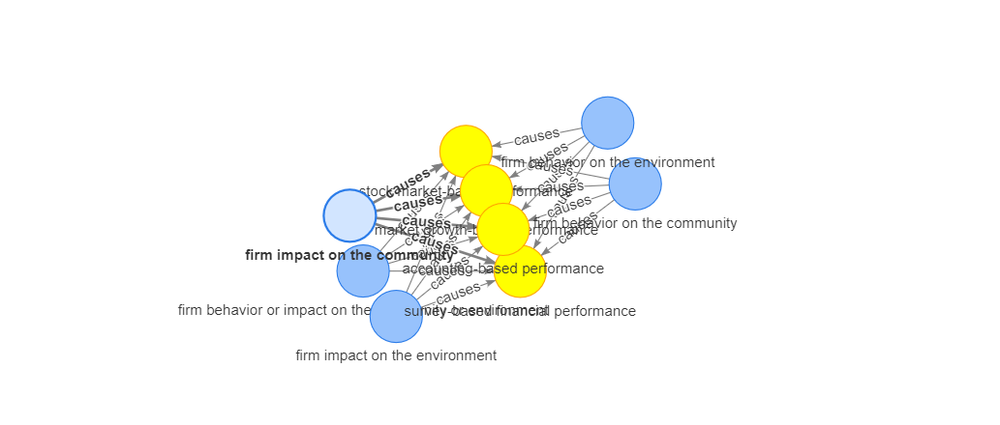

C:\Users\Owner\AppData\Local\Temp/ipykernel_20508/1638345404.py:6: UserWarning:

Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.



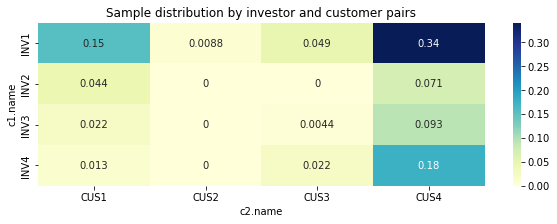

In [69]:
# Check data distribution
fig, ax = plt.subplots(figsize=(10,3))
sns.heatmap(pd.crosstab(df['c1.name'], df['c2.name'], normalize = True), 
            annot = True, cmap="YlGnBu")
ax.set_title('Sample distribution by investor and ' + c2 +" pairs")
fig.show()
fig.savefig("img/fig_sample_by_measure_" + c2 + ".png", bbox_inches='tight')

# Insert the figure into the same word doc
report = docx.Document("report_output_" + c2 + ".docx")
report.add_picture("img/fig_sample_by_measure_" + c2 + ".png")
report.save("report_output_" + c2 + ".docx")

### 3. Data analysis
#### 3.1 Meta-analysis of stakeholder benefit alignment, measured as pairwise correlations

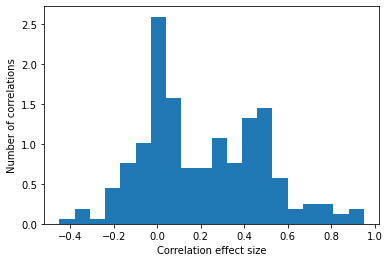

In [70]:
# Descriptive summary
plt.hist(df['r.correlation'], density=True, bins=20)
plt.ylabel('Number of correlations')
plt.xlabel('Correlation effect size')
plt.savefig("img/fig_corr_hist_" + c2 + ".png")

# Insert the figure into the same word doc
report = docx.Document("report_output_" + c2 + ".docx")
report.add_heading("3. Data Analysis", 1)
report.add_heading("3.1. Descriptive and Meta-Analysis", 2)
report.add_picture("img/fig_corr_hist_" + c2 + ".png")
report.save("report_output_" + c2 + ".docx")

C:\Users\Owner\AppData\Local\Temp/ipykernel_20508/4085295288.py:6: UserWarning:

Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.



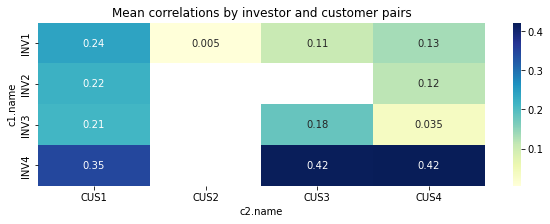

In [71]:
# Heatmap of mean correlations by variable category
fig, ax = plt.subplots(figsize=(10,3))
pivot = pd.pivot_table(df, values = 'r.correlation', index ='c1.name', columns = 'c2.name', aggfunc = 'mean') # need Patricio's help
sns.heatmap(pivot, annot = True, cmap="YlGnBu")
ax.set_title('Mean correlations by investor and ' + c2 +" pairs")
fig.show()
plt.savefig("img/fig_heatmap_bymeasure_" + c2 + ".png", bbox_inches='tight')

# Insert the figure into the same word doc
report = docx.Document("report_output_" + c2 + ".docx")
report.add_picture("img/fig_heatmap_bymeasure_" + c2 + ".png")
report.save("report_output_" + c2 + ".docx")

In [72]:
df['RN'] = df['r.correlation']*df['r.sample_size_observations'] 
df['N'] = df['r.sample_size_observations']
df['n'] = 1
columns = ['r.sample_country', 'r.sample_year', 'RN', 'N']

# meta-analyze correlations by year
df_by_time = df.sort_values(by = ['r.sample_year']).groupby(['r.sample_year'])
df_time = df_by_time.sum().reset_index()

df_time.columns = df_time.columns.str.replace('r.sample_','')
df_time.year = df_time.year.astype(int)
df_time['Mean_Correlation'] = (df_time.RN/df_time.N).round(3)
df_time['Mean_Correlation'] = df_time['Mean_Correlation'].fillna(0)
df_time['STD'] = df_by_time['r.correlation'].std().reset_index().fillna(0)['r.correlation']
df_time['STD'] = df_by_time['r.correlation'].std().reset_index().fillna(0)['r.correlation']
df_time['95% CI Lower'] = df_time['Mean_Correlation'] - 1.96*df_time['STD']/(df_time['n']**0.5)
df_time['95% CI Higher'] = df_time['Mean_Correlation'] + 1.96*df_time['STD']/(df_time['n']**0.5)
df_time['95% CI'] = '[' + df_time['95% CI Lower'].round(3).astype(str) + ' ~ ' + df_time['95% CI Higher'].round(3).astype(str) + ']'
df_time = df_time.dropna()

# meta-analyze correlations by country
df_by_country = df.sort_values(by = ['r.sample_country']).groupby(['r.sample_country'])
df_ctry = df_by_country.sum().reset_index()
df_ctry.columns = df_ctry.columns.str.replace('r.sample_','')
df_ctry = df_ctry.merge(pd.read_csv('iso.csv'), how = 'left')
df_ctry['Mean_Correlation'] = (df_ctry.RN/df_ctry.N).round(3)
df_ctry['Mean_Correlation'] = df_ctry['Mean_Correlation'].fillna(0)
df_ctry['Mean_Correlation_adjusted'] = df_ctry['Mean_Correlation'] + abs(df_ctry['Mean_Correlation'].min())
df_ctry = df_ctry.dropna()

# meta-analyze correlations by country and year
df_by_countryyear = df.sort_values(by = ['r.sample_year', 'r.sample_country']).groupby(['r.sample_year', 'r.sample_country'])
df_map = df_by_countryyear.sum().reset_index()
df_map.columns = df_map.columns.str.replace('r.sample_','')
df_map.year = df_map.year.astype(int)
df_map = df_map.merge(pd.read_csv('iso.csv'), how = 'left')
df_map['Mean_Correlation'] = (df_map.RN/df_map.N).round(3)
df_map['Mean_Correlation'] = df_map['Mean_Correlation'].fillna(0)
df_map['Mean_Correlation_adjusted'] = df_map['Mean_Correlation'] + abs(df_map['Mean_Correlation'].min())
df_map = df_map.dropna()

C:\Users\Owner\AppData\Local\Temp/ipykernel_20508/1569392709.py:10: FutureWarning:

The default value of regex will change from True to False in a future version.

C:\Users\Owner\AppData\Local\Temp/ipykernel_20508/1569392709.py:24: FutureWarning:

The default value of regex will change from True to False in a future version.

C:\Users\Owner\AppData\Local\Temp/ipykernel_20508/1569392709.py:34: FutureWarning:

The default value of regex will change from True to False in a future version.



##### 3.1.1. Show results over time

In [73]:
tab1 = df_time[['year', 'Mean_Correlation', '95% CI', 'size_observations']]
tab1.to_csv("tables/tab1_"+c2+".csv")

# Insert the table into the same word doc
report = docx.Document("report_output_" + c2 + ".docx")
report.add_heading("3.1.2. Mean correlation over years", 3)
# add a table to the end and create a reference variable
# extra row is so we can add the header row
t = report.add_table(tab1.shape[0]+1, tab1.shape[1])

# add the header rows.
for j in range(tab1.shape[-1]):
    t.cell(0,j).text = tab1.columns[j]

# add the rest of the data frame
for i in range(tab1.shape[0]):
    for j in range(tab1.shape[-1]):
        t.cell(i+1,j).text = str(tab1.values[i,j])

report.save("report_output_" + c2 + ".docx")

tab1 # need help from Patricio to show HOMA mean

,year,Mean_Correlation,95% CI,size_observations
0,1972,0.43,[0.43 ~ 0.43],23
1,1985,0.26,[0.11 ~ 0.41],1939
2,1988,0.17,[0.126 ~ 0.224],196
3,1990,0.29,[0.165 ~ 0.421],1298
4,1991,0.59,[0.478 ~ 0.696],4280
5,1992,0.01,[-0.049 ~ 0.067],3924
6,1993,0.34,[0.077 ~ 0.601],850
7,1994,0.06,[-0.078 ~ 0.204],1720
8,1995,0.46,[0.269 ~ 0.641],276
9,1996,0.08,[-0.015 ~ 0.167],16910


###### Visualization of results over time

C:\Users\Owner\AppData\Local\Temp/ipykernel_20508/3174147495.py:18: UserWarning:

Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.



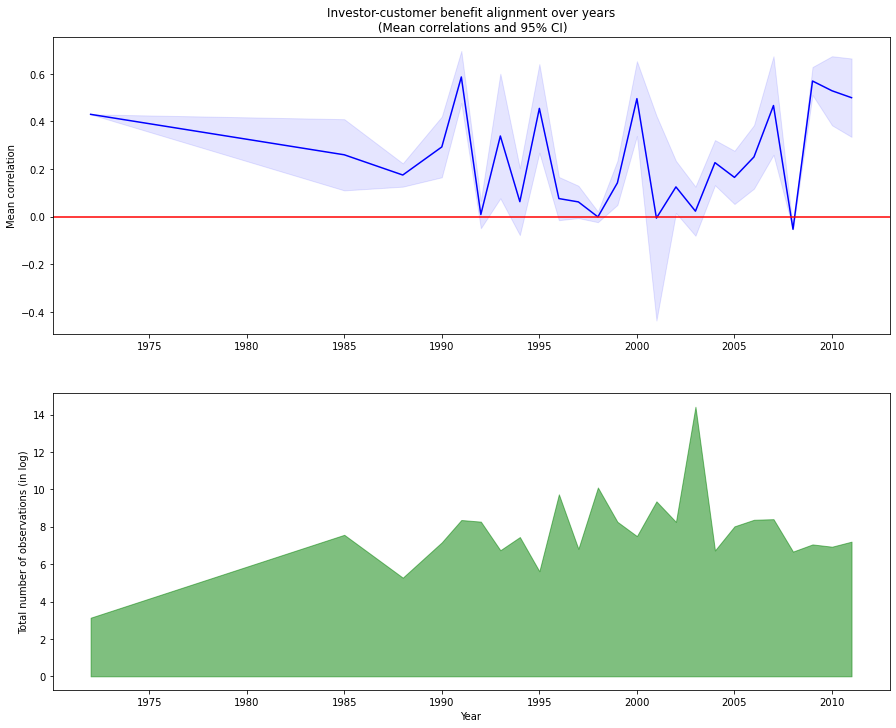

In [74]:
fig = plt.figure(figsize=(15,12))

# add the top line chart
lineplot = fig.add_subplot(2,1,1)
plt.plot(df_time.year, df_time.Mean_Correlation, color='b')
plt.fill_between(df_time.year, df_time['95% CI Lower'], df_time['95% CI Higher'], color='blue', alpha=.1)

plt.axhline(y=0, color='r', linestyle='-') # add a horizonal line Return ==0
plt.title('Investor-' + c2 +" benefit alignment over years\n (Mean correlations and 95% CI)")
plt.ylabel('Mean correlation')

# add the bottom bar chart
barplot = fig.add_subplot(2,1,2)
plt.fill_between(df_time.year, np.log(df_time.size_observations), color='g', alpha=.5)
plt.ylabel('Total number of observations (in log)')
plt.xlabel('Year')

fig.show() # need help from Patrico to correctly show HOMA mean, 95% CI, and N, k
fig.savefig("img/fig_line_overyears_" + c2 + ".png", bbox_inches='tight')

# Insert the figure into the same word doc
report = docx.Document("report_output_" + c2 + ".docx")
report.add_picture("img/fig_line_overyears_" + c2 + ".png")
report.save("report_output_" + c2 + ".docx")

##### 3.1.2. Show results across nations/markets
**<font color='red'><center>Notes for software developer: The following cell contains inputs from the user.</center><font>**

How would you like to see the results?
1 by nations/markets,
2 by nations/markets and year.2


C:\Users\Owner\AppData\Local\Temp/ipykernel_20508/3937110874.py:16: UserWarning:

Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.



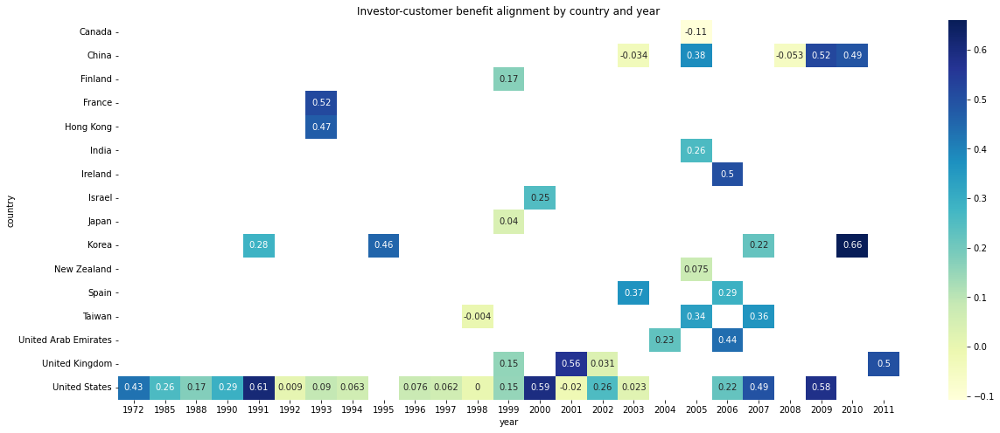

In [75]:
mode = int(input("""How would you like to see the results?
1 by nations/markets,
2 by nations/markets and year."""))

if mode == 1:
    fig, ax = plt.subplots(figsize=(10,5))
    sns.heatmap(df_ctry.set_index('country')[['Mean_Correlation']], 
                annot = True, cmap="YlGnBu")
    ax.set_title('Investor-' + c2 +" benefit alignment by country")
    fig.show()
elif mode ==2:
    fig, ax = plt.subplots(figsize=(20,8))
    sns.heatmap(df_map.pivot_table(values = 'Mean_Correlation', index='country', columns='year'), 
                annot = True, cmap="YlGnBu")
    ax.set_title('Investor-' + c2 +" benefit alignment by country and year")
    fig.show()
else:
    pass

fig.savefig("img/fig_heatmap_bycountry_" + c2 + ".png", bbox_inches='tight')

# Insert the figure into the same word doc
report = docx.Document("report_output_" + c2 + ".docx")
report.add_heading("3.1.3. Mean correlation across countries/markets", 3)
report.add_picture("img/fig_heatmap_bycountry_" + c2 + ".png")
report.save("report_output_" + c2 + ".docx")

##### Visualization of results across nations/markets

In [76]:
fig = px.choropleth(df_ctry, locations="ISO3",
                    color="Mean_Correlation", # lifeExp is a column of gapminder
                    hover_name="country", # column to add to hover information
                    color_continuous_scale=px.colors.sequential.Plasma,
                   range_color=(df_time.Mean_Correlation.min(),df_time.Mean_Correlation.max()))
fig.show()
fig.write_image("img/fig_heatmap_worldmap_" + c2 + ".png")

# Insert the figure into the same word doc
report = docx.Document("report_output_" + c2 + ".docx")
report.add_picture("img/fig_heatmap_worldmap_" + c2 + ".png")
report.save("report_output_" + c2 + ".docx")

In [77]:
fig = px.choropleth(df_map, locations="ISO3",
                    color="Mean_Correlation", # lifeExp is a column of gapminder
                    hover_name="country", # column to add to hover information
                    color_continuous_scale=px.colors.sequential.Plasma,
                   animation_frame="year",
                   range_color=(df_time.Mean_Correlation.min(),df_time.Mean_Correlation.max()))
fig.show()

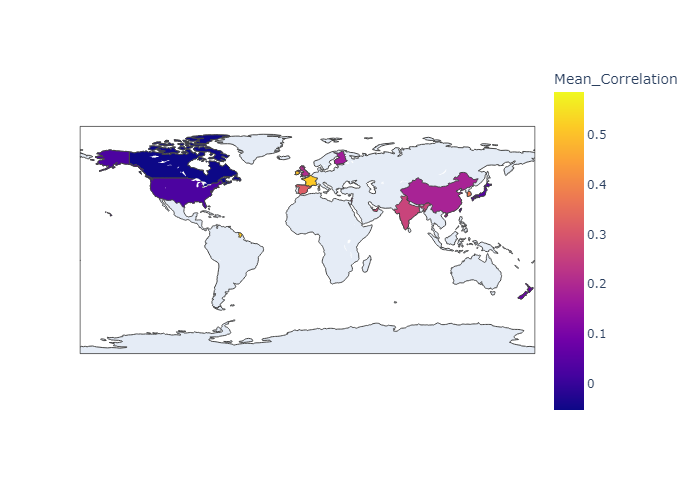

In [5]:
from IPython.display import Image
Image(filename='img/fig_heatmap_worldmap_customer.png')

#### 3.2. Meta-regressions

In [78]:
df.columns = df.columns.str.replace('.', '_')
df.columns = df.columns.str.replace('r_sample_', '')
df.columns = df.columns.str.replace('r_', '')
df = df.dropna()
df.year = df.year.astype(int)
df = df.merge(pd.read_csv('iso.csv'), how = 'inner')
df.info() # Need help from Patricio to program meta-regression, now it's just OLS

<class 'pandas.core.frame.DataFrame'>
Int64Index: 226 entries, 0 to 225
Data columns (total 16 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   c1_level1          226 non-null    object 
 1   c1_name            226 non-null    object 
 2   c2_level1          226 non-null    object 
 3   c2_name            226 non-null    object 
 4   publication        226 non-null    object 
 5   correlation        226 non-null    float64
 6   size_firms         226 non-null    int64  
 7   size_observations  226 non-null    int64  
 8   country            226 non-null    object 
 9   year               226 non-null    int32  
 10  c1_label           226 non-null    object 
 11  c2_label           226 non-null    object 
 12  RN                 226 non-null    float64
 13  N                  226 non-null    int64  
 14  n                  226 non-null    int64  
 15  ISO3               226 non-null    object 
dtypes: float64(2), int32(1), i

C:\Users\Owner\AppData\Local\Temp/ipykernel_20508/2913707036.py:1: FutureWarning:

The default value of regex will change from True to False in a future version. In addition, single character regular expressions will *not* be treated as literal strings when regex=True.



In [79]:
# Load institutional variables, along with control variables about each sample's meta-data information
df_inst = pd.read_csv('institutional_vars.csv')
# remove interactive variables, with '*' or '.' in column labels
columns = [i for i in df_inst.columns if not "*" in i and not "." in i] 
df_inst = df_inst[columns]
df_inst.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 414 entries, 0 to 413
Data columns (total 24 columns):
 #   Column                                               Non-Null Count  Dtype  
---  ------                                               --------------  -----  
 0   publication                                          414 non-null    object 
 1   method                                               414 non-null    object 
 2   source                                               414 non-null    object 
 3   Liquidity of market of exist for customers           255 non-null    float64
 4   Strength of legal protection for customers           255 non-null    float64
 5   Strength of collective representation for customers  255 non-null    float64
 6   Liquidity of market of exist for employees           255 non-null    float64
 7   Strength of legal protection for employees           70 non-null     float64
 8   Strength of collective representation for employees  0 non-null      f

In [89]:
# Merge with correlation dataset
dfreg = df.merge(df_inst, how = 'left').drop_duplicates()
dfreg.columns = dfreg.columns.str.replace(' ', '_')
dfreg = dfreg.dropna(axis=1, how='all')
dfreg.info() # Warning: it seems to be overmatched!!!

<class 'pandas.core.frame.DataFrame'>
Int64Index: 614 entries, 0 to 613
Data columns (total 37 columns):
 #   Column                                               Non-Null Count  Dtype  
---  ------                                               --------------  -----  
 0   c1_level1                                            614 non-null    object 
 1   c1_name                                              614 non-null    object 
 2   c2_level1                                            614 non-null    object 
 3   c2_name                                              614 non-null    object 
 4   publication                                          614 non-null    object 
 5   correlation                                          614 non-null    float64
 6   size_firms                                           614 non-null    int64  
 7   size_observations                                    614 non-null    int64  
 8   country                                              614 non-null    o

##### 3.2.1. Linear Meta-Regressions

In [57]:
# Subset of columns for analysis

regcolumns = ['correlation', 'c1_name', 'c2_name', 
              'LN_real_GDP','LN_real_GDP_per_capita',
              'Panel_design','year', 'Impact_factor']

linvvars = [i for i in dfreg.columns if 'investor' in i]
lc2vars = [i for i in dfreg.columns if c2 in i]

regcolumns = regcolumns + linvvars + lc2vars

dfreg = dfreg[regcolumns].dropna()
tab1 = dfreg.describe().round(2).T
tab1.to_csv("tables/tab_metareg_summary_" + c2 + ".csv")

# Insert the table into the same word doc
report = docx.Document("report_output_" + c2 + ".docx")
report.add_heading("3.2. Meta-regression", 2)
report.add_heading("3.2.1. Summary statistics of variables for meta-regression", 3)

# add a table to the end and create a reference variable
# extra row is so we can add the header row
t = report.add_table(tab1.shape[0]+1, tab1.shape[1])

# add the header rows.
for j in range(tab1.shape[-1]):
    t.cell(0,j).text = tab1.columns[j]

# add the rest of the data frame
for i in range(tab1.shape[0]):
    for j in range(tab1.shape[-1]):
        t.cell(i+1,j).text = str(tab1.values[i,j])

report.save("report_output_" + c2 + ".docx")

tab1

,count,mean,std,min,25%,50%,75%,max
correlation,601.00,0.20,0.29,-0.45,-0.01,0.17,0.46,0.95
LN_real_GDP,601.00,28.98,1.29,25.54,28.05,29.83,30.13,30.34
LN_real_GDP_per_capita,601.00,10.34,0.74,6.88,10.37,10.52,10.69,11.00
Panel_design,601.00,0.57,0.50,0.00,0.00,1.00,1.00,1.00
year,601.00,"2,000.60",4.98,"1,990.00","1,998.00","2,002.00","2,003.00","2,011.00"
Impact_factor,601.00,1.90,1.83,0.00,0.60,1.45,2.38,6.48
Liquidity_of_market_of_exist_for_investors,601.00,93.69,43.70,7.40,56.44,85.14,127.33,227.54
Strength_of_legal_protection_for_investors,601.00,6.19,0.87,3.95,6.25,6.25,6.63,7.75
Strength_of_collective_representation_for_investors,601.00,0.65,0.17,0.35,0.64,0.65,0.65,0.96
Liquidity_of_market_of_exist_for_customers,601.00,0.92,0.39,0.22,0.65,0.91,1.20,1.78


In [58]:
formula = 'correlation ~ 1 + C(c1_name) + C(c2_name) \
+ LN_real_GDP + LN_real_GDP_per_capita + C(Panel_design) + year \
+ Impact_factor + '

invvars = ' + '.join(linvvars) + ' + '
c2vars = ' + '.join(lc2vars)

res = smf.ols(formula = formula + invvars + c2vars, data=dfreg).fit()
tab = res.summary()

write_path = "tables/tab_metareg_ols_" + c2 + ".csv"
with open(write_path, 'w') as f:
    f.write(tab.as_csv())

tab1 = pd.concat((res.params, res.tvalues, res.pvalues), axis=1).round(2)
tab1 = tab1.rename(columns={0: 'Coeff', 1: 't value', 2: 'p value'})
tab1.index = tab1.index.str.replace('_', ' ')
tab1.index = tab1.index.str.replace('T.', '')
tab1.index = tab1.index.str.strip("()")
tab1.to_csv("tables/tab_metareg_ols_" + c2 + "_short.csv")

# Insert the table into the same word doc
report = docx.Document("report_output_" + c2 + ".docx")
report.add_heading("3.2.2. Meta-regression results", 3)

# add a table to the end and create a reference variable
# extra row is so we can add the header row
t = report.add_table(tab1.shape[0]+1, tab1.shape[1])

# add the header rows.
for j in range(tab1.shape[-1]):
    t.cell(0,j).text = tab1.columns[j]

# add the rest of the data frame
for i in range(tab1.shape[0]):
    for j in range(tab1.shape[-1]):
        t.cell(i+1,j).text = str(tab1.values[i,j])

report.save("report_output_" + c2 + ".docx")

tab

C:\Users\Owner\AppData\Local\Temp/ipykernel_20508/3566764259.py:18: FutureWarning:

The default value of regex will change from True to False in a future version.



<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:            correlation   R-squared:                       0.405
Model:                            OLS   Adj. R-squared:                  0.387
Method:                 Least Squares   F-statistic:                     23.30
Date:                Sat, 11 Dec 2021   Prob (F-statistic):           6.60e-55
Time:                        00:27:43   Log-Likelihood:                 57.648
No. Observations:                 601   AIC:                            -79.30
Df Residuals:                     583   BIC:                           -0.1221
Df Model:                          17                                         
Covariance Type:            nonrobust                                         
=======================================================================================================================
                                                          coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------------------------------------------------------------------------------------
Intercept                                              18.0503      8.902      2.028      0.043       0.567      35.534
C(c1_name)[T.INV2]                                     -0.0663      0.035     -1.869      0.062      -0.136       0.003
C(c1_name)[T.INV3]                                     -0.0180      0.032     -0.558      0.577      -0.081       0.045
C(c1_name)[T.INV4]                                      0.4027      0.032     12.691      0.000       0.340       0.465
C(c2_name)[T.CUS2]                                     -0.1504      0.164     -0.918      0.359      -0.472       0.172
C(c2_name)[T.CUS3]                                     -0.0761      0.050     -1.526      0.128      -0.174       0.022
C(c2_name)[T.CUS4]                                     -0.0556      0.029     -1.924      0.055      -0.112       0.001
C(Panel_design)[T.1.0]                                 -0.0645      0.022     -2.917      0.004      -0.108      -0.021
LN_real_GDP                                            -0.0043      0.019     -0.226      0.821      -0.041       0.033
LN_real_GDP_per_capita                                  0.0107      0.020      0.528      0.597      -0.029       0.051
year                                                   -0.0090      0.004     -2.037      0.042      -0.018      -0.000
Impact_factor                                          -0.0365      0.008     -4.750      0.000      -0.052      -0.021
Liquidity_of_market_of_exist_for_investors              0.0010      0.000      2.173      0.030    9.42e-05       0.002
Strength_of_legal_protection_for_investors              0.0224      0.019      1.189      0.235      -0.015       0.059
Strength_of_collective_representation_for_investors     0.0612      0.077      0.794      0.428      -0.090       0.213
Liquidity_of_market_of_exist_for_customers             -0.0077      0.024     -0.318      0.751      -0.055       0.040
Strength_of_legal_protection_for_customers              0.0013      0.001      2.077      0.038    6.94e-05       0.002
Strength_of_collective_representation_for_customers    -0.0083      0.012     -0.703      0.482      -0.031       0.015
==============================================================================
Omnibus:                        5.064   Durbin-Watson:                   0.561
Prob(Omnibus):                  0.080   Jarque-Bera (JB):                5.114
Skew:                           0.224   Prob(JB):                       0.0775
Kurtosis:                       2.947   Cond. No.                     1.96e+06
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly 

C:\Users\Owner\AppData\Local\Temp/ipykernel_20508/1736589347.py:6: FutureWarning:

The default value of regex will change from True to False in a future version.



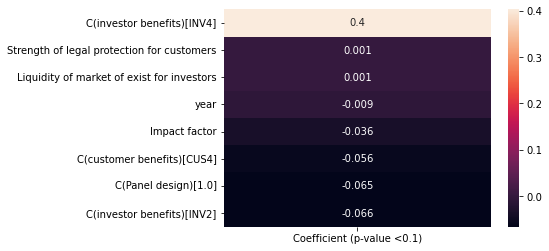

In [59]:
# Show only statistically significant variables (p<0.1)
sig_vars = pd.DataFrame(res.params[res.pvalues < 0.1][1:], 
                        columns = ['Coefficient (p-value <0.1)']).sort_values(by = 
                        ['Coefficient (p-value <0.1)'], ascending = False)
sig_vars.index = sig_vars.index.str.replace('_', ' ')
sig_vars.index = sig_vars.index.str.replace('T.', '')
sig_vars.index = sig_vars.index.str.replace('c1 name', 'investor benefits')
sig_vars.index = sig_vars.index.str.replace('c2 name', c2+' benefits')

sns.heatmap(sig_vars.round(3), annot = True)
plt.savefig("img/fig_metareg_sigcoeff_" + c2 + ".png", bbox_inches='tight')

# Insert the figure into the same word doc
report = docx.Document("report_output_" + c2 + ".docx")
report.add_picture("img/fig_metareg_sigcoeff_" + c2 + ".png")
report.save("report_output_" + c2 + ".docx")

##### 3.2.2. Machine Learning


The most accurate model is: <class 'sklearn.ensemble._gb.GradientBoostingRegressor'>
Accuracy score: 0.717


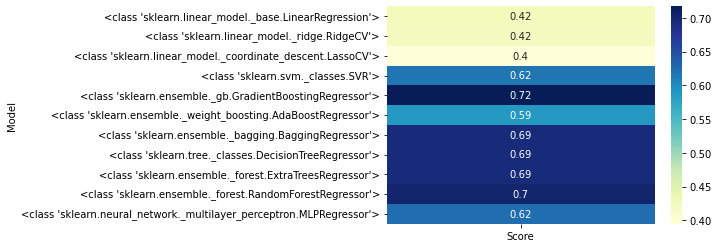

In [60]:
from sklearn.compose import make_column_selector as selector
from sklearn.preprocessing import OneHotEncoder, StandardScaler
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import make_pipeline
from sklearn.model_selection import train_test_split

dfreg = dfreg.dropna()
dfX = dfreg.iloc[:, 1:]
dfY = dfreg['correlation']

numerical_columns_selector = selector(dtype_exclude=object)
categorical_columns_selector = selector(dtype_include=object)

numerical_columns = numerical_columns_selector(dfX)
categorical_columns = categorical_columns_selector(dfX)


categorical_preprocessor = OneHotEncoder(handle_unknown="ignore")
numerical_preprocessor = StandardScaler()


preprocessor = ColumnTransformer([
    ('one-hot-encoder', categorical_preprocessor, categorical_columns),
    ('standard_scaler', numerical_preprocessor, numerical_columns)])
    
scores = []
model_list = [Reg, RidgeCV, LassoCV, SVR, Gradient, Boost, Bagging, Tree, ExtraTree, RF, NN]
for i in model_list:
    model = make_pipeline(preprocessor, i())

    data_train, data_test, target_train, target_test = train_test_split(dfX, dfY, random_state=1983) 
    _ = model.fit(data_train, target_train)
    scores.append(model.score(data_test, target_test).round(3)) # out-of-sample score

tab1 = pd.DataFrame(zip(model_list, scores), columns = ['Model', 'Score']).set_index('Model')

sns.heatmap(tab1, annot = True, cmap="YlGnBu")

plt.savefig("img/fig_metaML_modelScores_" + c2 + ".png", bbox_inches='tight')

# Insert the figure into the same word doc
report = docx.Document("report_output_" + c2 + ".docx")
report.add_heading("3.3. Meta-Machine Learning (ML)", 2)
report.add_heading("3.3.1. Model performance report", 3)
report.add_picture("img/fig_metaML_modelScores_" + c2 + ".png")
report.save("report_output_" + c2 + ".docx")

bestmodel = model_list[scores.index(max(scores))]
bestscore = max(scores)
print("\nThe most accurate model is:", bestmodel)
print("Accuracy score:", max(scores).round(3))

Importance Ranking (Incremental Score in % to the Model Accuracy)


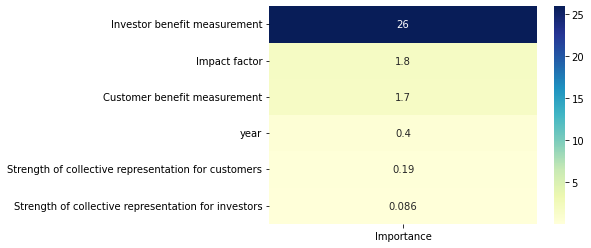

In [61]:
importance = pd.DataFrame(dfX.columns, columns = ['Importance']).set_index(dfX.columns)
importance['Importance'] = None
importance_value =[]

for i in dfX.columns:
    dfreg = dfreg.dropna()
    dfX = df_reg.iloc[:, 1:].drop([i], axis=1)
    dfY = df_reg['correlation']

    numerical_columns = numerical_columns_selector(dfX)
    categorical_columns = categorical_columns_selector(dfX)

    preprocessor = ColumnTransformer([
        ('one-hot-encoder', categorical_preprocessor, categorical_columns),
        ('standard_scaler', numerical_preprocessor, numerical_columns)])

    model = make_pipeline(preprocessor, bestmodel())

    data_train, data_test, target_train, target_test = train_test_split(dfX, dfY, random_state=1983) 
    _ = model.fit(data_train, target_train)
    score = model.score(data_test, target_test)
    
    importance_value.append((bestscore - score)*100) # out-of-sample score  
    
importance['Importance'] = importance_value

importance.index = importance.index.str.replace('_', ' ')
importance.index = importance.index.str.replace('c1 name', 'Investor benefit measurement')
importance.index = importance.index.str.replace('c2 name', c2.capitalize()+' benefit measurement')

importance = importance[importance.Importance >0] # only show positive contributors

sns.heatmap(importance.sort_values(by = ['Importance'], ascending = False).round(3), annot = True, cmap="YlGnBu")
print("Importance Ranking (Incremental Score in % to the Model Accuracy)")

plt.savefig("img/fig_metaML_bestmodel_" + c2 + ".png", bbox_inches='tight')

# Insert the figure into the same word doc
report = docx.Document("report_output_" + c2 + ".docx")
report.add_heading("3.3.2. Best model feature importance", 3)
report.add_picture("img/fig_metaML_bestmodel_" + c2 + ".png")
report.save("report_output_" + c2 + ".docx")

### Extra: Updating the Knowledge Graph DB

In this demonstration, I show how users can query and analyze existing knowledge data from the knowledge graph DB. As suggested in project 1, expert users can also 'teach' knowledge into the knowledge graph DB to bring the data analysis up-to-date. Please see **[XKEP website](https://www.gopeaks.org/expert-knowledge-exchange-platform)** for details.

I have developed a professional community to engage citizen scientists to create and cumulate a shared knowledge graph DB, and develop tools for making decisions.

***Final notes:*** *In this project, I have censored and modified data from the original datasets. The meta-analysis is following a simplified formula just for demonstration purposes. For the actual meta-analysis approach, please refer to the original publication entitled [<b>Multi-Stakeholder Agency: Stakeholder Benefit Alignment and National Institutional Contexts</b>](https://journals.sagepub.com/doi/abs/10.1177/01492063211054403) (In-Press at the ***Journal of Management***, co-authored with Patricio Duran, Steve Sauerwald, Mike Hitt, and Marc van Essen).*

# <center> Okay, now I need GPT-3 to help me write a paper on this! </center>

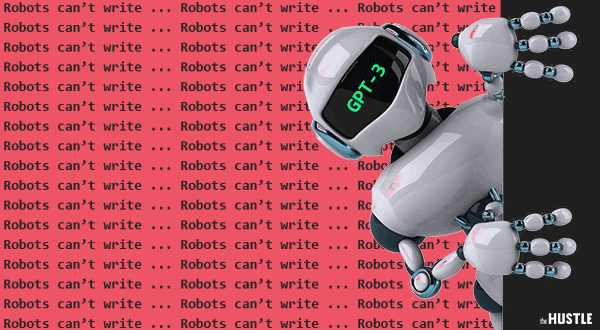

In [ ]:
import os
import openai
openai.api_key = "sk-***"

stop = False
write = ""
while stop == False:
    myPrompt = str(input())
    
    if myPrompt.lower() == 'save this gibberish':
        stop = True
    else:
        response = openai.Completion.create(
          engine="davinci",
          prompt=myPrompt,
          temperature=0.9,
          max_tokens=150,
          top_p=1,
          n=1,
          stream = None,
          logprobs = None,
          frequency_penalty=0,
          presence_penalty=0.6,
          stop=["\n\n"]
        )
        
        write += f"{myPrompt}{response.choices[0].text}"
        print(f"{myPrompt}{response.choices[0].text}")

print("Save this as a discussion section in the paper!")
        
# Write this gibberish into the same word doc
report = docx.Document("report_output_" + c2 + ".docx")
report.add_heading("3.4. Discussion", 2)
report.add_paragraph(write)
report.save("report_output_" + c2 + ".docx")